In [9]:
import os
import sys
import pickle
import urllib.request
import warnings
import colorsys



import numpy as np
import pandas as pd
import seaborn as sns
from Bio import SeqIO
from Bio.PDB import DSSP
from Bio.PDB.PDBParser import PDBParser
from Bio import BiopythonWarning
from sklearn.multioutput import MultiOutputRegressor
from sklearn.linear_model import MultiTaskLassoCV, LassoCV, LogisticRegressionCV, LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.decomposition import IncrementalPCA

import nglview

from sklearn.preprocessing import StandardScaler

import matplotlib.cm as cm
import matplotlib.pyplot as plt

np.set_printoptions(precision=4)
np.set_printoptions(suppress=True)

sys.path.append('../../settings/')
import settings

sys.path.append('../common/')
import data_io_utils
import plot_style_utils

import A008_common

warnings.simplefilter('ignore', BiopythonWarning)

%reload_ext autoreload
%autoreload 2

In [2]:
RANDOM_PDB_SEQS_DIR = os.path.join(settings.S3_DATA_ROOT, 'swiss_pca', '20181011_pdb_seqres_downsampled')
PDB_DUMP_DIR = os.path.join(RANDOM_PDB_SEQS_DIR, 'pdb')

EXAMPLE_PROTEINS_FOR_VIZ_DIR = os.path.join(settings.S3_DATA_ROOT, 'swiss_pca', 'lacrepressors_gpcrs_dhfr_gfp')

data_io_utils.sync_s3_path_to_local(RANDOM_PDB_SEQS_DIR)
data_io_utils.sync_s3_path_to_local(EXAMPLE_PROTEINS_FOR_VIZ_DIR)

In [3]:
HIDDEN_SEQS = np.load(os.path.join(EXAMPLE_PROTEINS_FOR_VIZ_DIR, 'hidden_sequences.npy'))
seq_fasta = os.path.join(EXAMPLE_PROTEINS_FOR_VIZ_DIR, 'lacrepressors_gpcrs_dhfr_gfp.fasta')
EXAMPLE_HEADERS = []
EXAMPLE_SEQS = []
for seq_record in SeqIO.parse(seq_fasta, 'fasta'):
    EXAMPLE_HEADERS.append(seq_record.id)
    EXAMPLE_SEQS.append(str(seq_record.seq))

In [4]:
with open('rep_model_helix.p', 'rb') as f:
        rep_model_helix = pickle.load(f)

with open('rep_model_sheet.p', 'rb') as f:
    rep_model_sheet = pickle.load(f)

with open('rep_model_asa.p', 'rb') as f:
    rep_model_asa = pickle.load(f)
    
with open('rep_model_helix_top_neuron.p', 'rb') as f:
    rep_model_helix_top_neuron = pickle.load(f)
        
with open('rep_model_helix_top_ss_shared_neurons.p', 'rb') as f:
    rep_model_helix_top_ss_shared_neurons = pickle.load(f)
    
with open('rep_model_sheet_top_neuron.p', 'rb') as f:
    rep_model_helix_top_neuron = pickle.load(f)
        
with open('rep_model_sheet_top_ss_shared_neurons.p', 'rb') as f:
    rep_model_helix_top_ss_shared_neurons = pickle.load(f)


with open('rep_pc_model_helix.p', 'rb') as f:
    rep_pc_model_helix = pickle.load(f)

with open('rep_pc_model_sheet.p', 'rb') as f:
    rep_pc_model_sheet = pickle.load(f)

with open('rep_pc_model_asa.p', 'rb') as f:
    rep_pc_model_asa = pickle.load(f)
    
    

/home/ubuntu/GitHub/protein-representation-learning-analysis/venv/lib/python3.5/site-packages/sklearn/base.py:315: UserWarning: Trying to unpickle estimator LassoCV from version 0.19.2 when using version 0.18.1. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)


### Define colormap

In [126]:
from matplotlib.colors import LinearSegmentedColormap

custom_cmap = LinearSegmentedColormap.from_list(
    name='custom', 
    colors=[seq_colors[0], seq_colors[0], [0.9, 0.9, 0.9], seq_colors[1], seq_colors[1]]
)

In [128]:
sns.palplot(custom_cmap(np.arange()))

TypeError: object of type 'LinearSegmentedColormap' has no len()

In [130]:
custom_cmap(np.arange(0,10))

array([[0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ],
       [0.5333, 0.8   , 0.9333, 1.    ]])

## Visualize

In [121]:
nglview_pdbid = A008_common.nglview_pdbid
window_cartoon = A008_common.window_cartoon

# Overload of version in A008_common
def visualize_protein_given_hidden_seq_model(pdb_id, hidden_seq_to_prop_val, cmap=custom_cmap,
        chain=':A', orientation_pickle=None, seq=None, hseq=None, 
        default_headers=EXAMPLE_HEADERS, default_seqs=EXAMPLE_SEQS, default_hseqs=HIDDEN_SEQS):

        return A008_common.visualize_protein_given_hidden_seq_model(
            pdb_id,
            hidden_seq_to_prop_val,
            PDB_DUMP_DIR,
            cmap=cmap,
            chain=chain,
            orientation_pickle=orientation_pickle,
            seq=seq,
            hseq=hseq,
            default_headers=default_headers,
            default_seqs=default_seqs,
            default_hseqs=default_hseqs
        )

# Lac Repressor

In [122]:
PDB_ID = '2PE5'
ORIENTATION_PICKLE = PDB_ID + '_orientation.p'

## Supervised Helix Model

In [102]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_helix.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [103]:
if False: 
    orientation = view._camera_orientation
    with open(ORIENTATION_PICKLE, 'wb') as f:
            pickle.dump(orientation, f)

In [104]:
view.render_image()

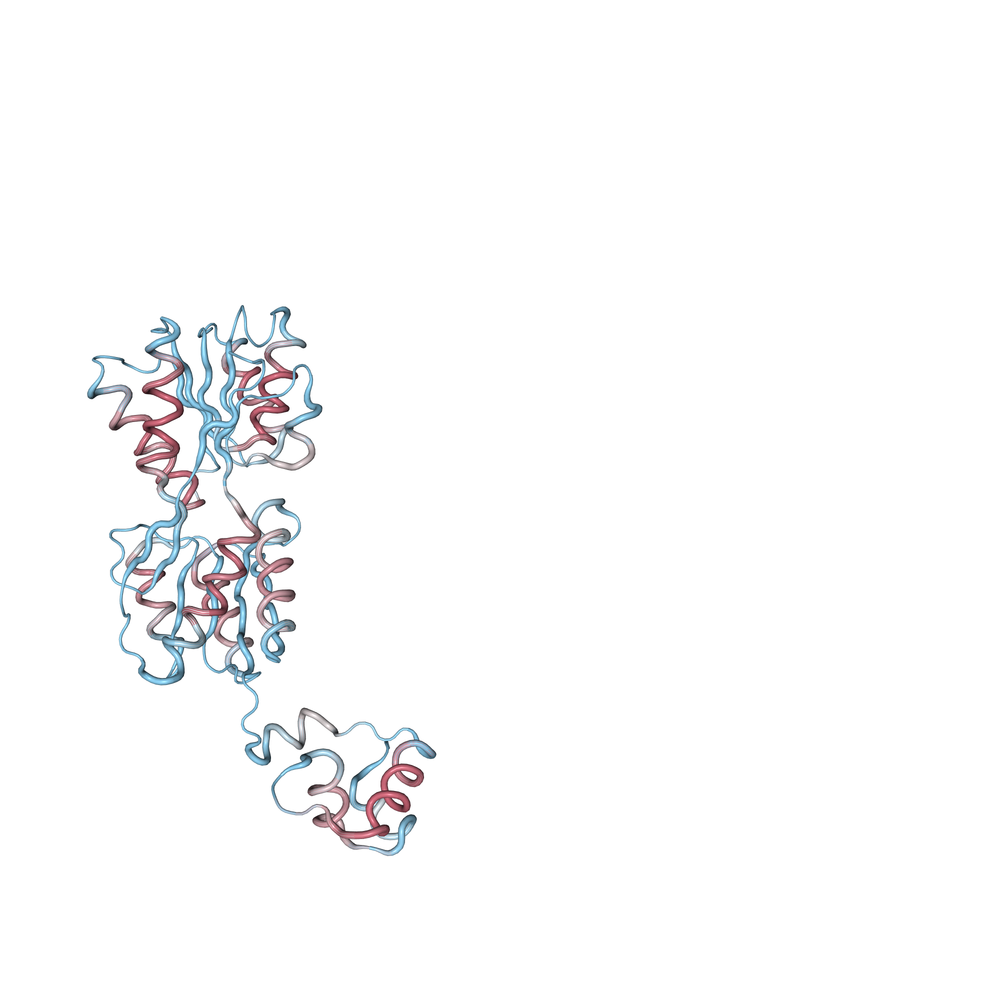

In [105]:
view._display_image()

## Supervised Sheet Model

In [12]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_sheet.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [13]:
view.render_image()

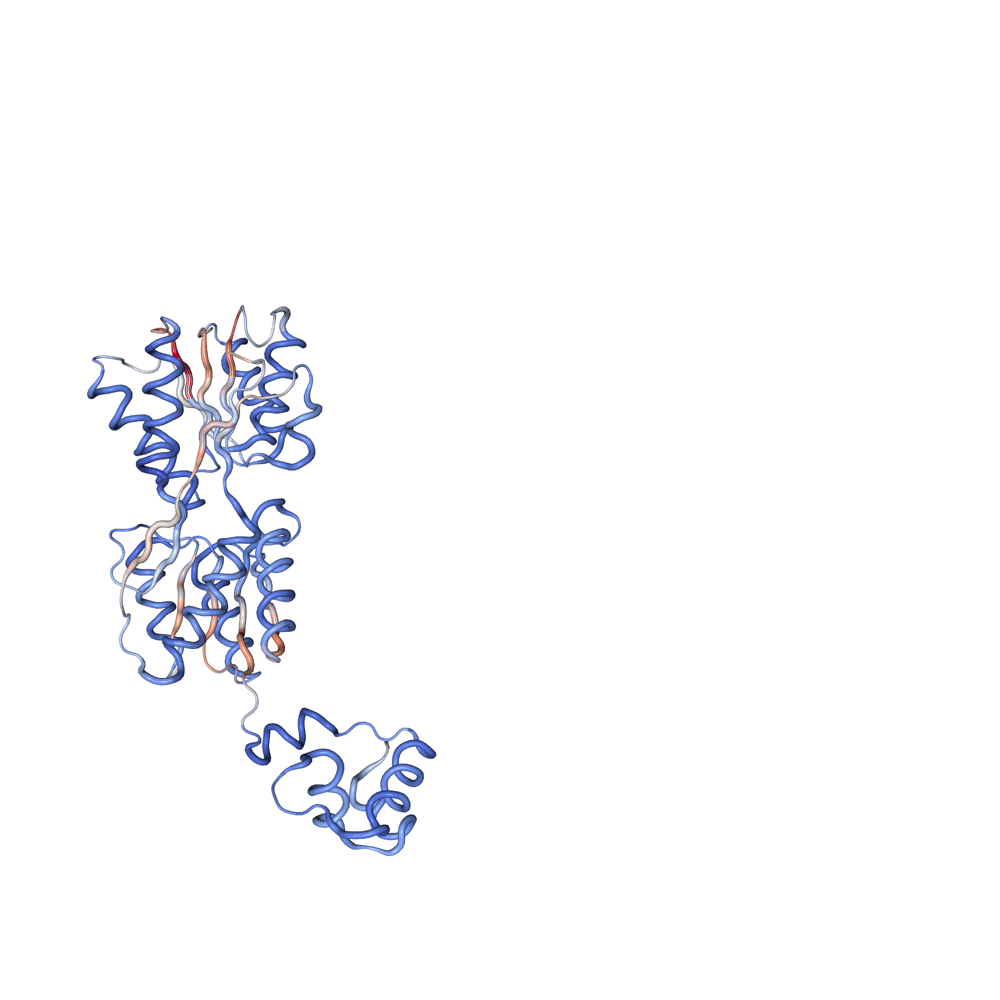

In [14]:
view._display_image()

## Solvent accessibility model

In [15]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_asa.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [16]:
view.render_image()

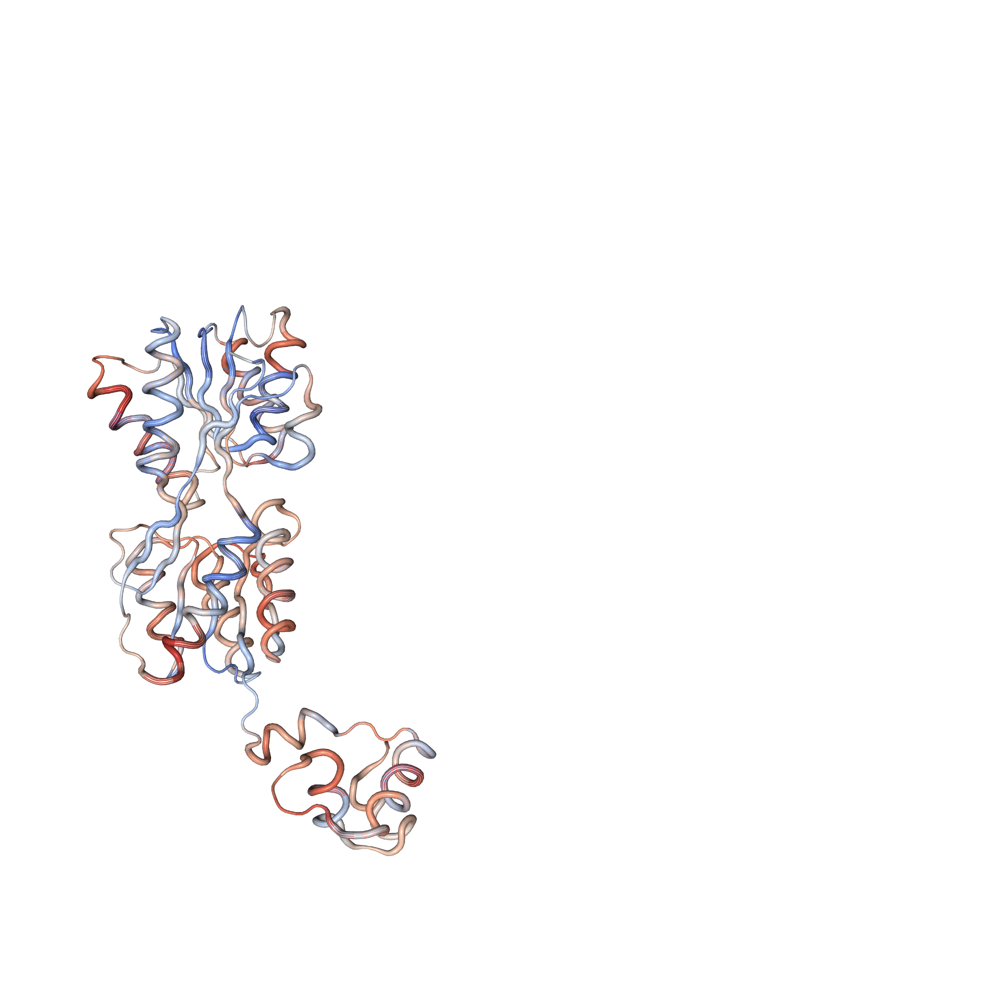

In [17]:
view._display_image()

## Top Helix Neuron

In [123]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_HELIX_NEURON].reshape(-1,1)*A008_common.TOP_HELIX_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)

view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [124]:
view.render_image()

In [125]:
view.download_image(filename='2PE5_LacRepressor_top_helix_neuron.png', trim=True, transparent=True)

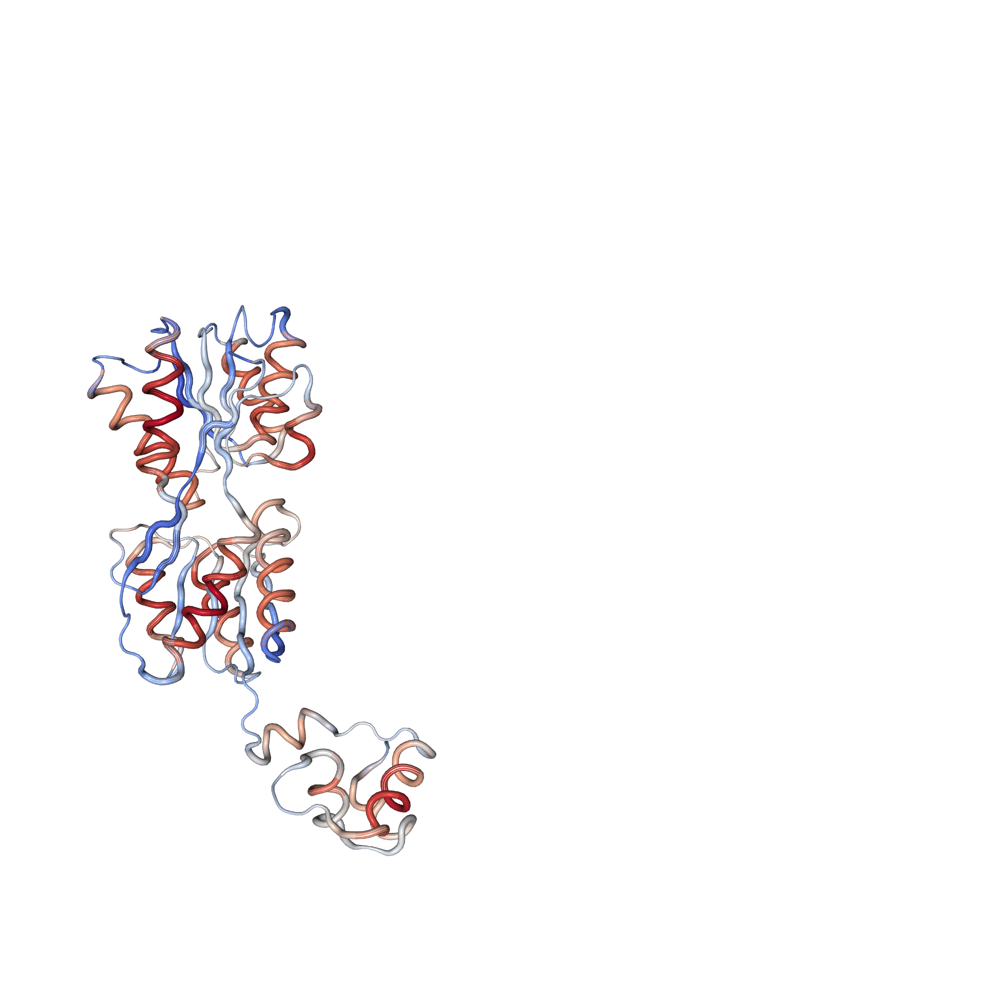

In [23]:
view._display_image()

## Top Sheet Neuron

In [24]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_SHEET_NEURON].reshape(-1,1)*A008_common.TOP_SHEET_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)

view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [25]:
view.render_image()

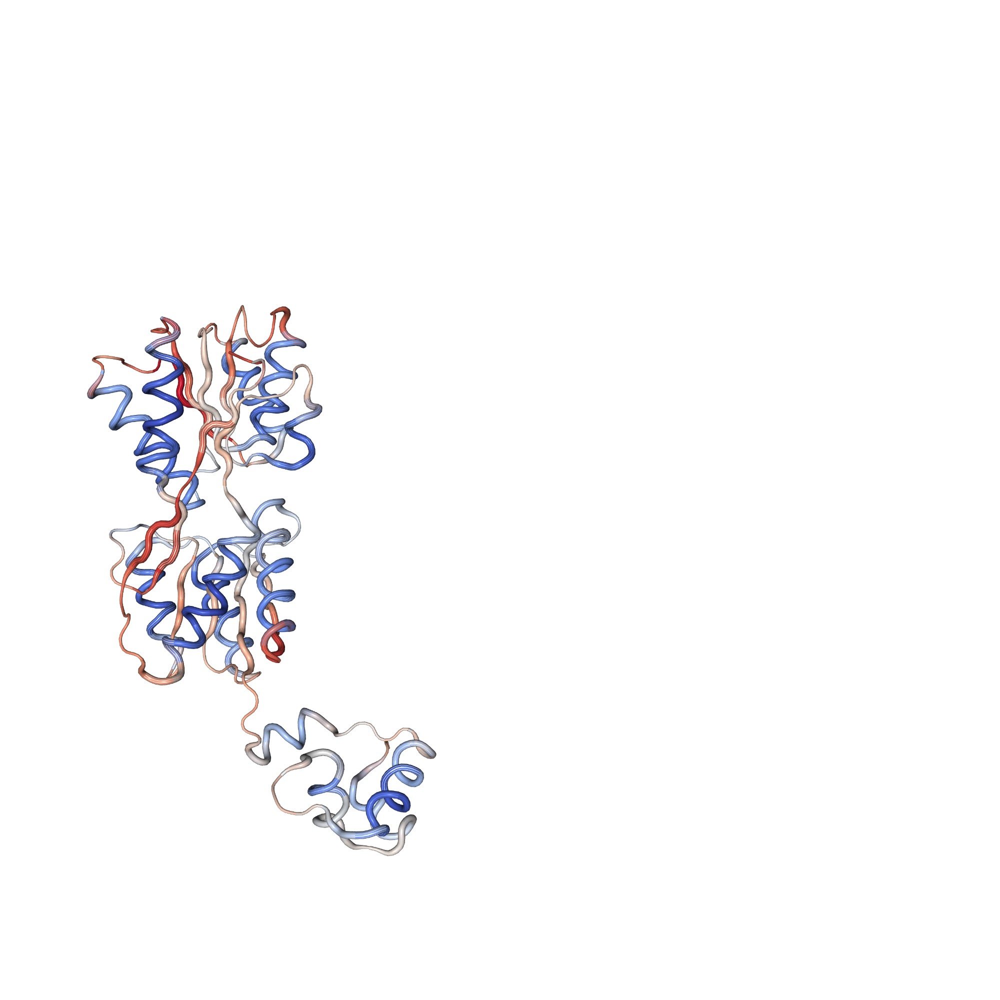

In [26]:
view._display_image()

## Stability Predictor (4 co-activated neurons found in Rocklin analysis)

In [31]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, A008_common.stability_predictor, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [32]:
view.render_image()

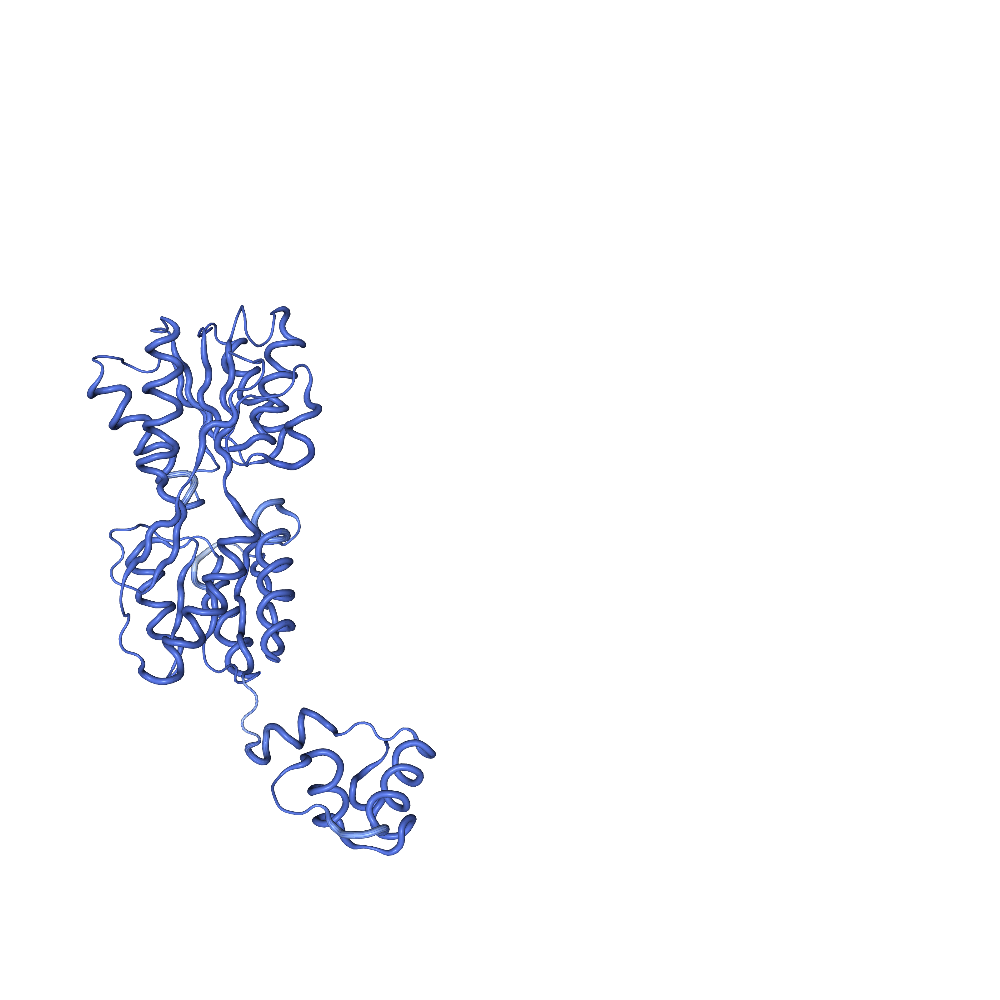

In [33]:
view._display_image()

# DHFR

In [40]:
PDB_ID = '4KJK'
ORIENTATION_PICKLE = PDB_ID + '_orientation.p'

## Supervised Helix Model

In [45]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_helix.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [46]:
if False: 
    orientation = view._camera_orientation
    with open(ORIENTATION_PICKLE, 'wb') as f:
            pickle.dump(orientation, f)

In [47]:
view.render_image()

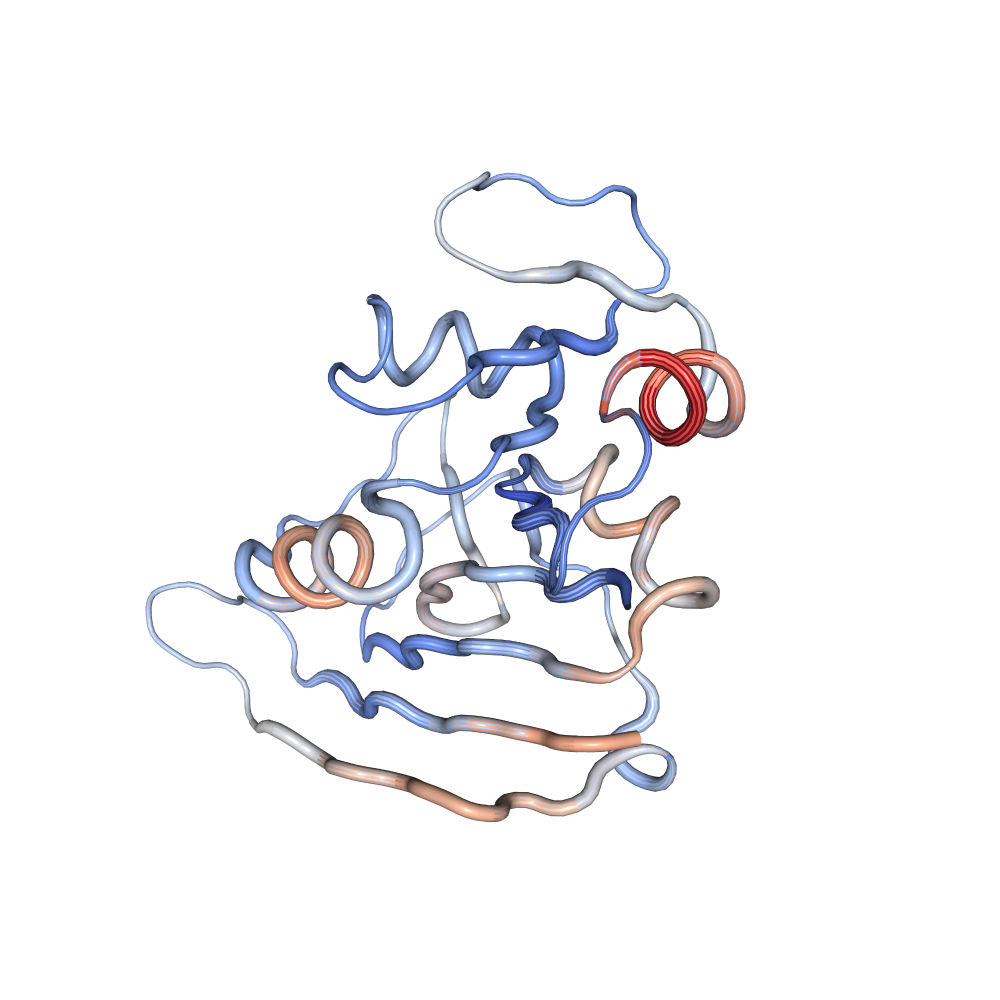

In [48]:
view._display_image()

## Supervised Sheet Model

In [49]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_sheet.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [50]:
view.render_image()

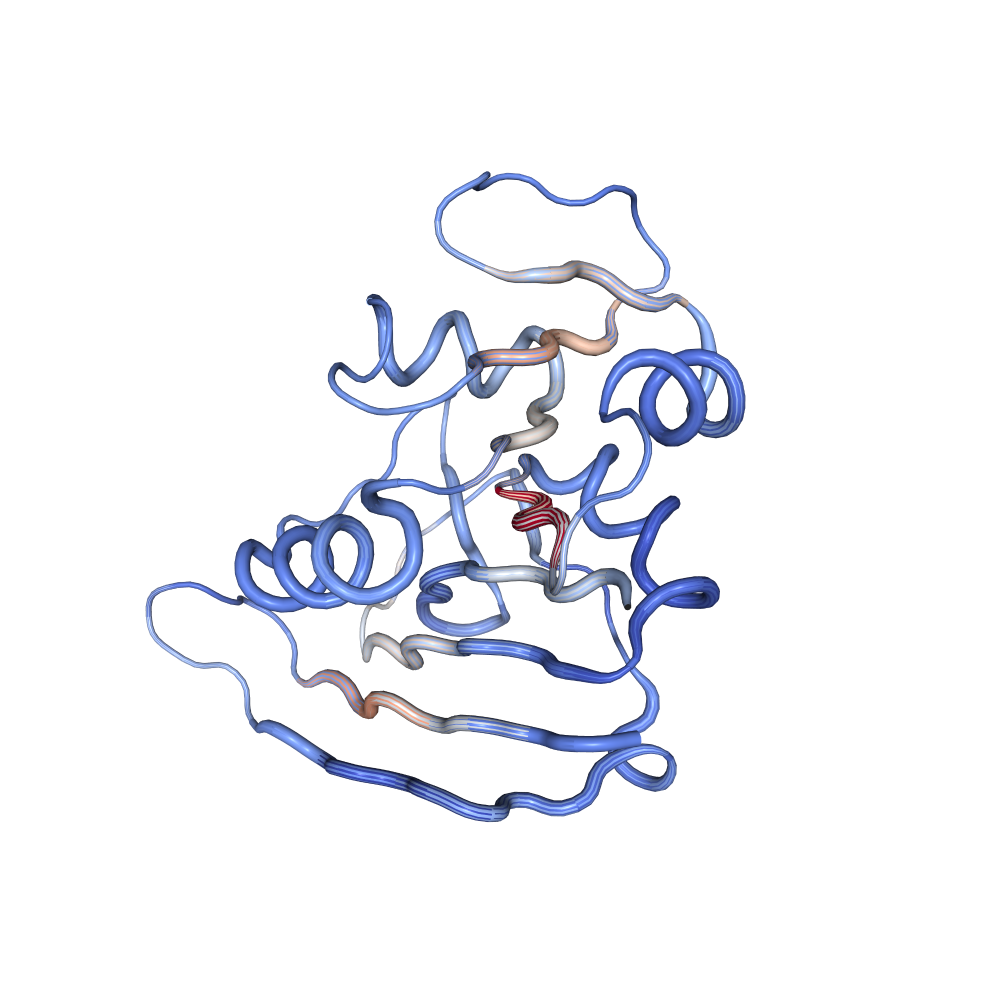

In [51]:
view._display_image()

## Solvent accessibility model

In [52]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_asa.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [53]:
view.render_image()

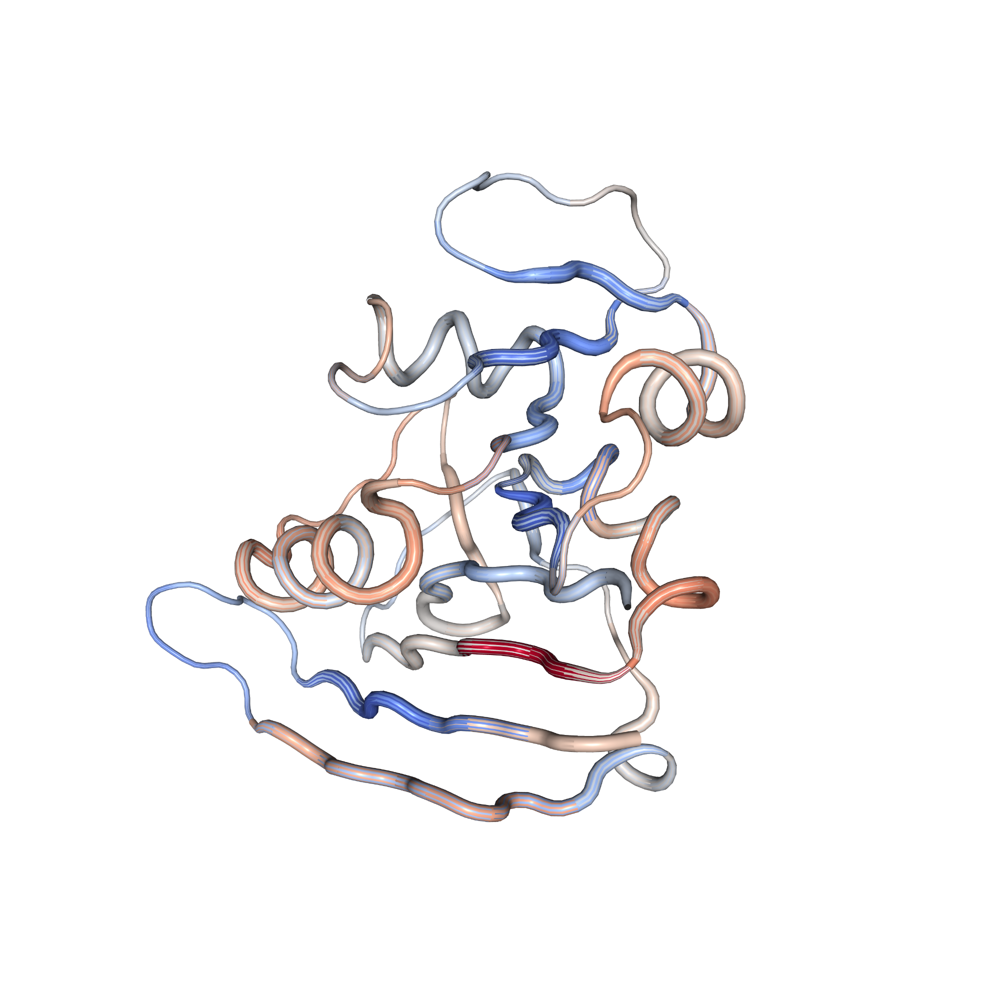

In [54]:
view._display_image()

## Top Helix Neuron

In [55]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_HELIX_NEURON].reshape(-1,1)*A008_common.TOP_HELIX_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)

view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [56]:
view.render_image()

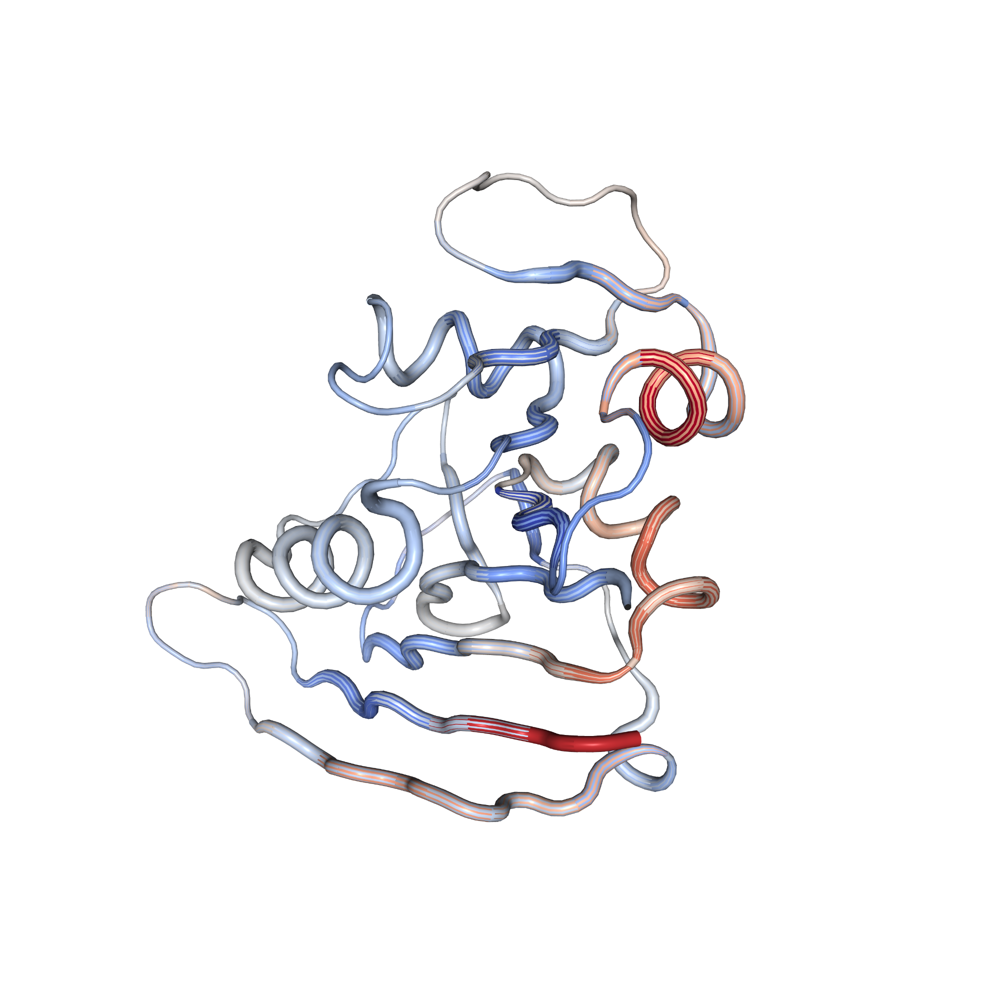

In [57]:
view._display_image()

## Top Sheet Neuron

In [58]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_SHEET_NEURON].reshape(-1,1)*A008_common.TOP_SHEET_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)

view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [61]:
view.render_image()

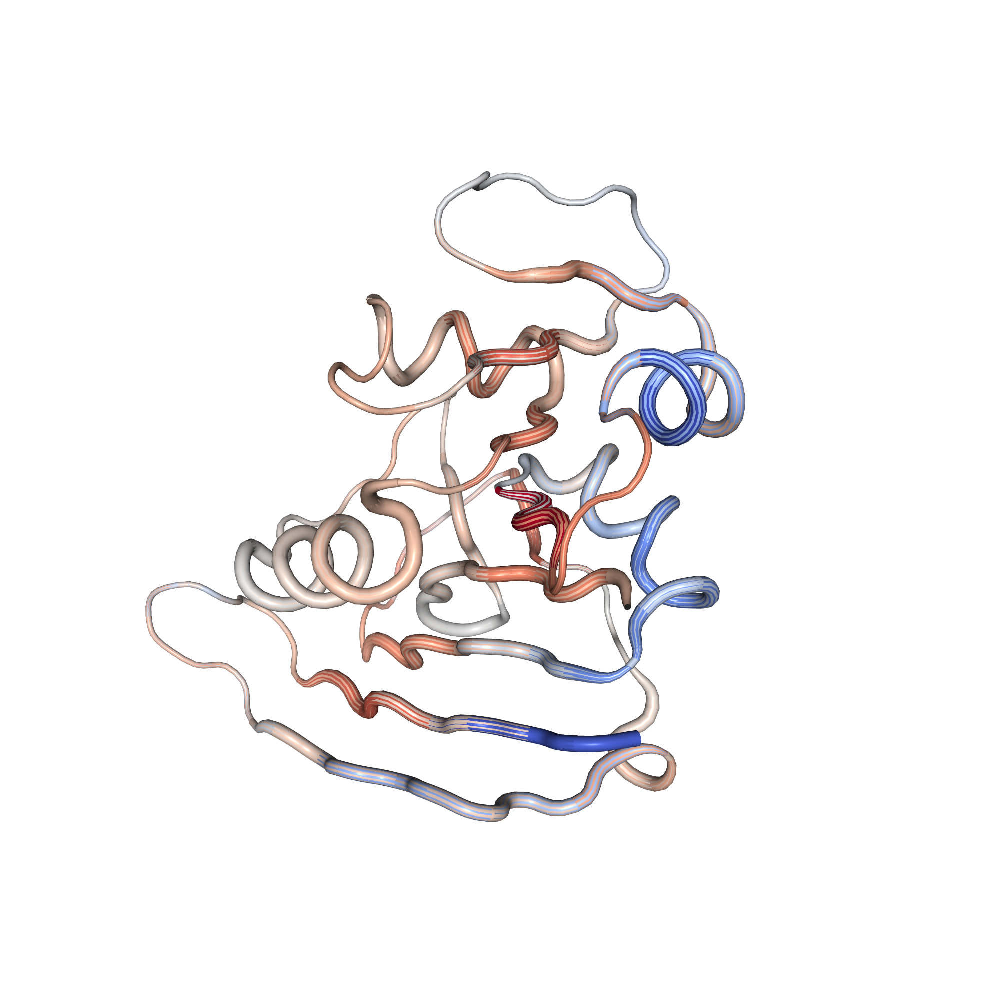

In [62]:
view._display_image()

## Stability Predictor (4 co-activated neurons found in Rocklin analysis)

In [63]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, A008_common.stability_predictor, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [64]:
view.render_image()

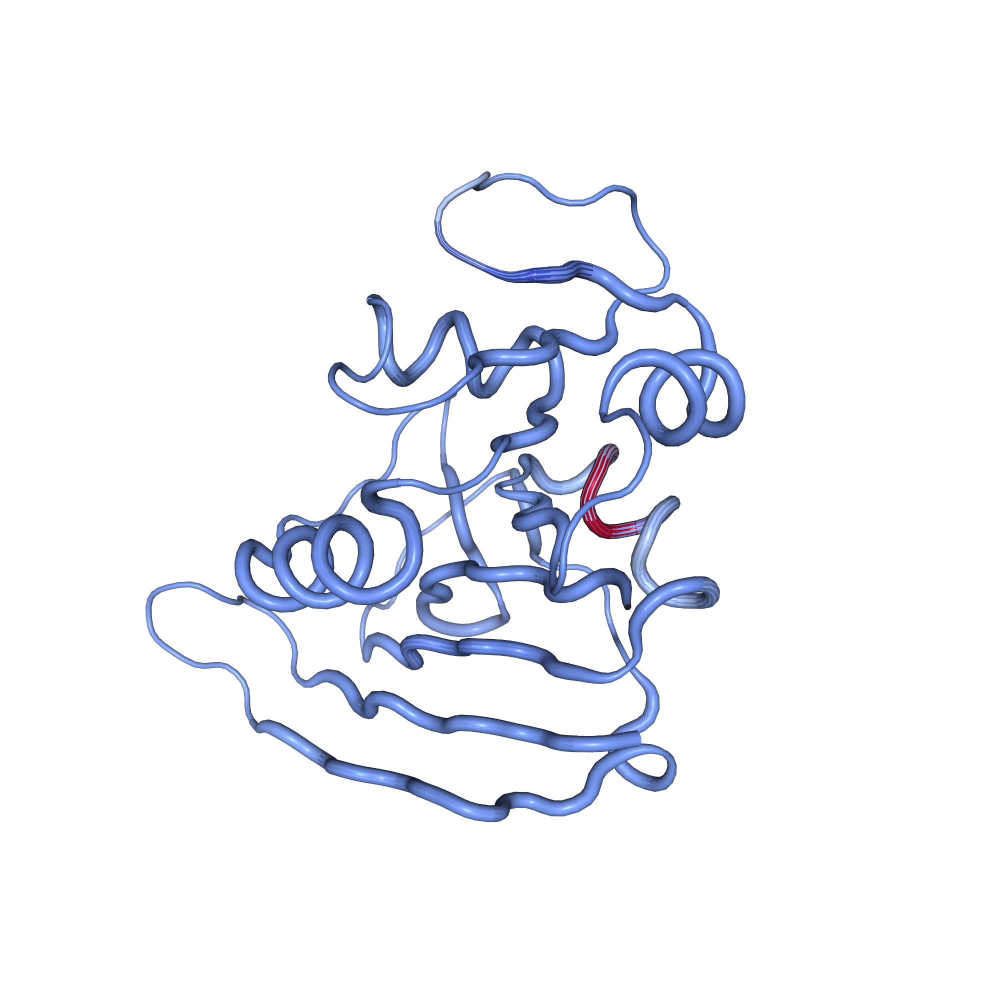

In [65]:
view._display_image()

# GPCR

In [109]:
PDB_ID = '1F88'
ORIENTATION_PICKLE = PDB_ID + '_orientation.p'

## Supervised Helix Model

In [28]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_helix.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

TypeError: string indices must be integers

In [71]:
if False: 
    orientation = view._camera_orientation
    with open(ORIENTATION_PICKLE, 'wb') as f:
            pickle.dump(orientation, f)

In [72]:
view.render_image()

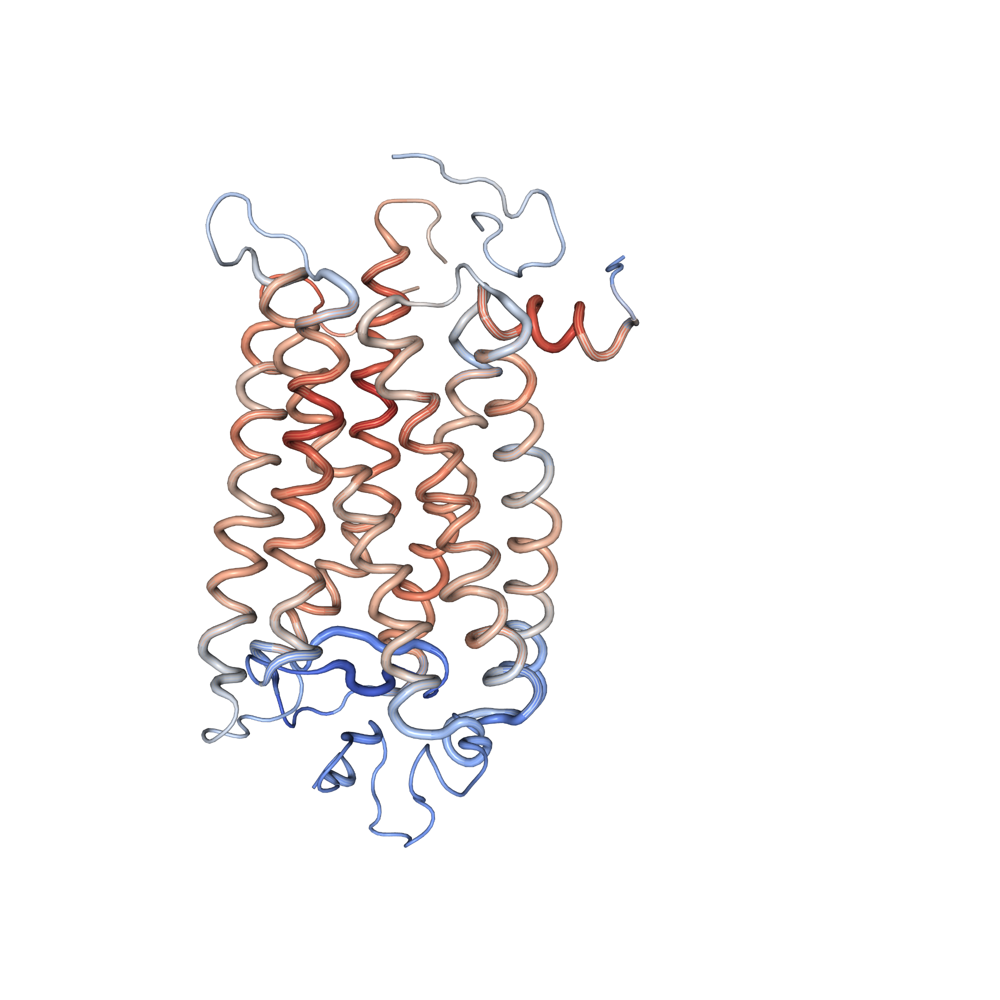

In [73]:
view._display_image()

## Supervised Sheet Model

In [74]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_sheet.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [75]:
view.render_image()

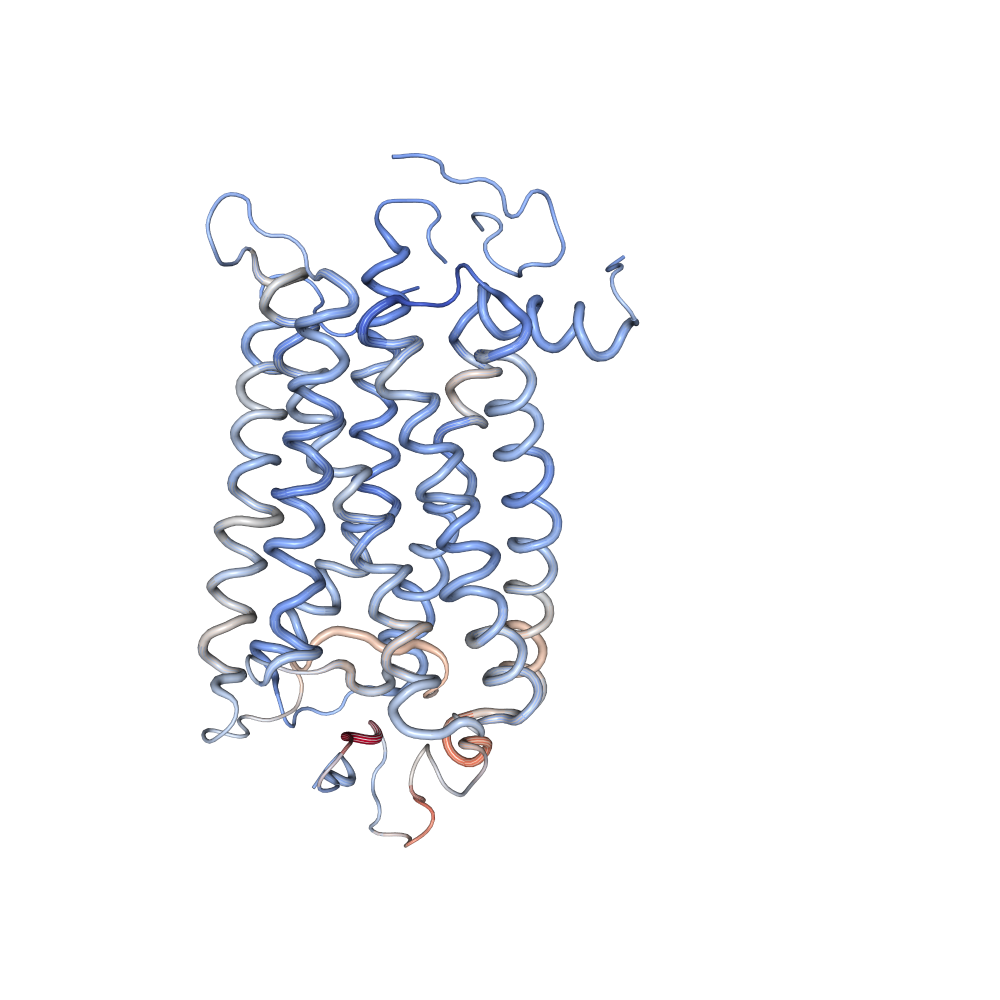

In [76]:
view._display_image()

## Solvent accessibility model

In [110]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_asa.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [111]:
view.render_image()

In [112]:
view.download_image(filename='1F88_GPCR_solvent_accessibility_model.png', trim=True, transparent=True)

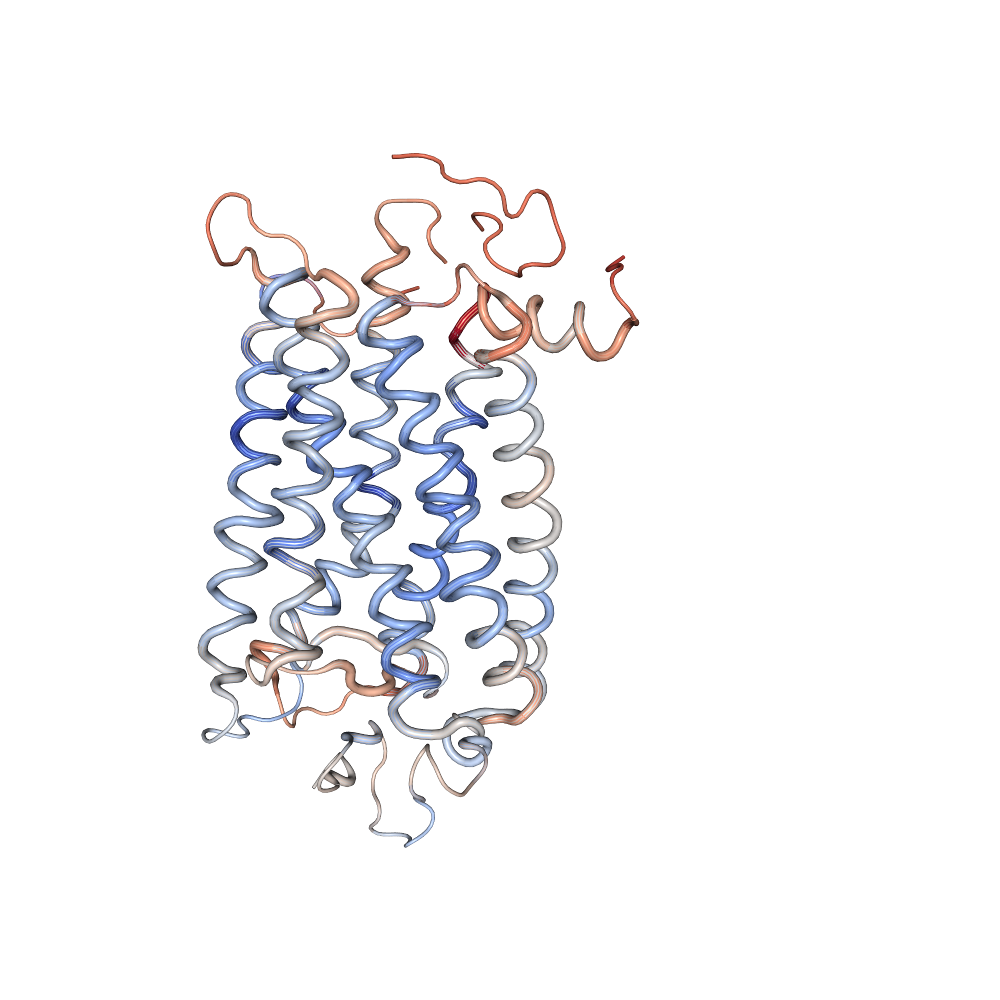

In [79]:
view._display_image()

## Top Helix Neuron

In [80]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_HELIX_NEURON].reshape(-1,1)*A008_common.TOP_HELIX_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)

view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [81]:
view.render_image()

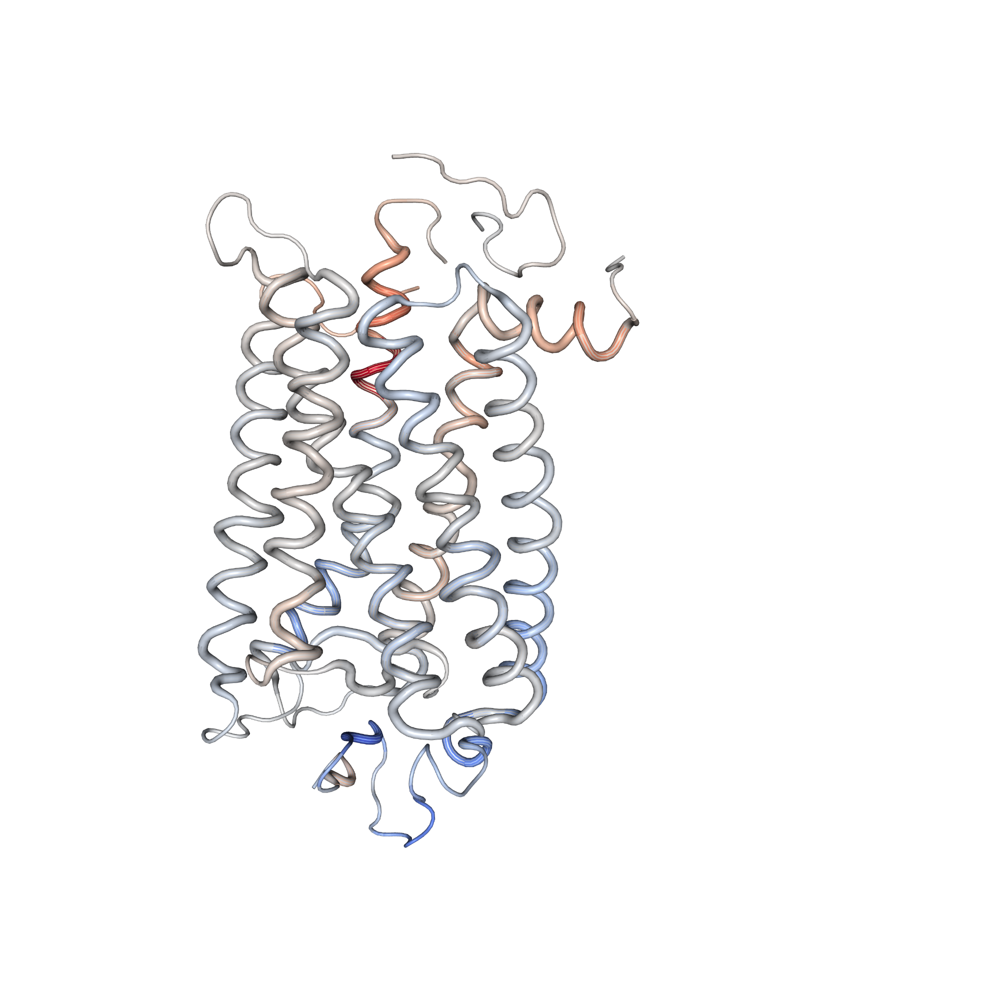

In [82]:
view._display_image()

## Top Sheet Neuron

In [83]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_SHEET_NEURON].reshape(-1,1)*A008_common.TOP_SHEET_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)

view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [84]:
view.render_image()

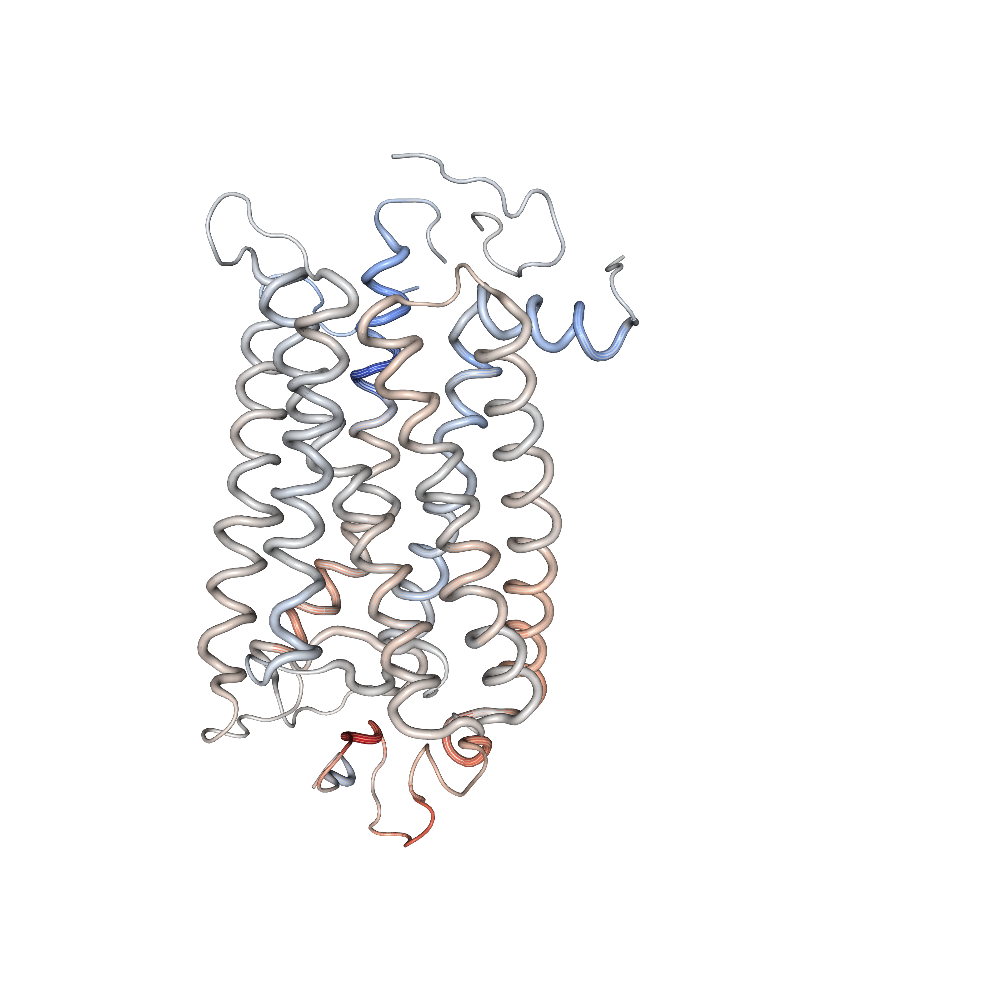

In [85]:
view._display_image()

## Stability Predictor (4 co-activated neurons found in Rocklin analysis)

In [86]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, A008_common.stability_predictor, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [87]:
view.render_image()

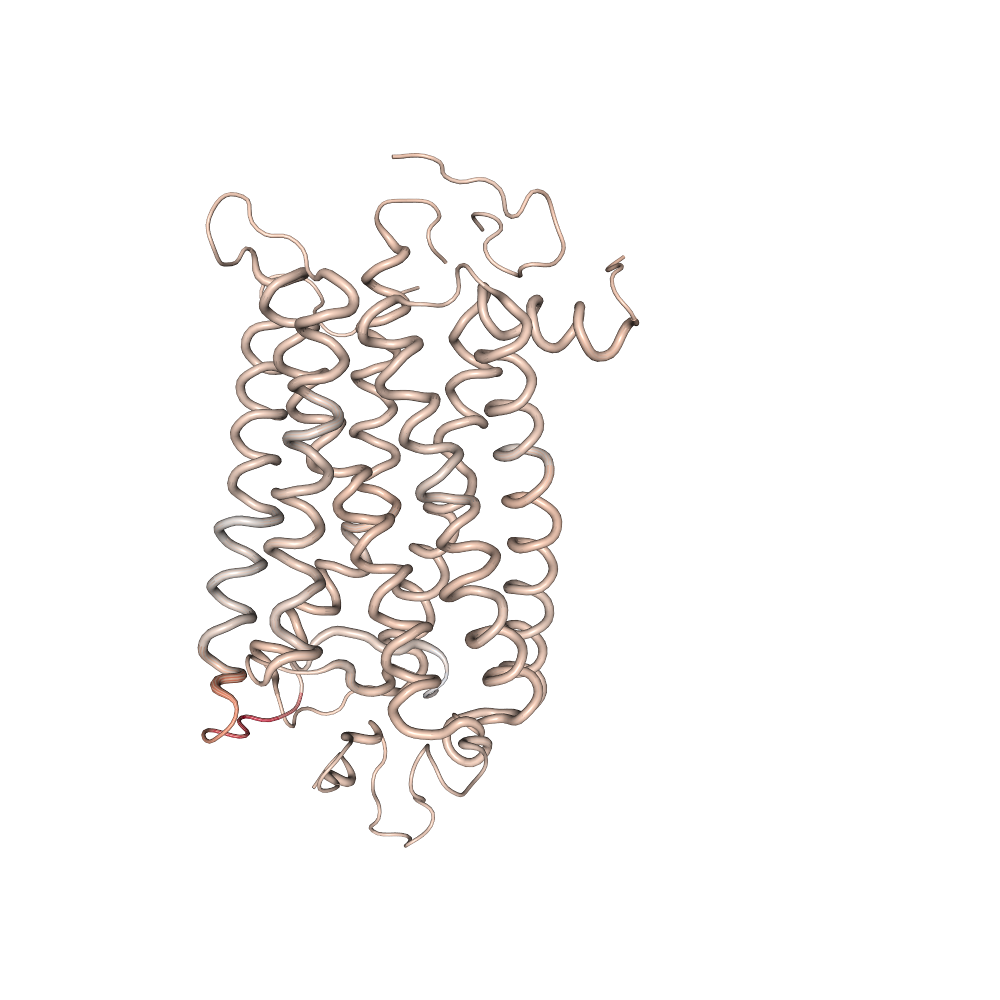

In [88]:
view._display_image()

# GFP

In [89]:
PDB_ID = '1GFL'
ORIENTATION_PICKLE = PDB_ID + '_orientation.p'

## Supervised Helix Model

In [92]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_helix.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [93]:
if False: 
    orientation = view._camera_orientation
    with open(ORIENTATION_PICKLE, 'wb') as f:
            pickle.dump(orientation, f)

In [94]:
view.render_image()

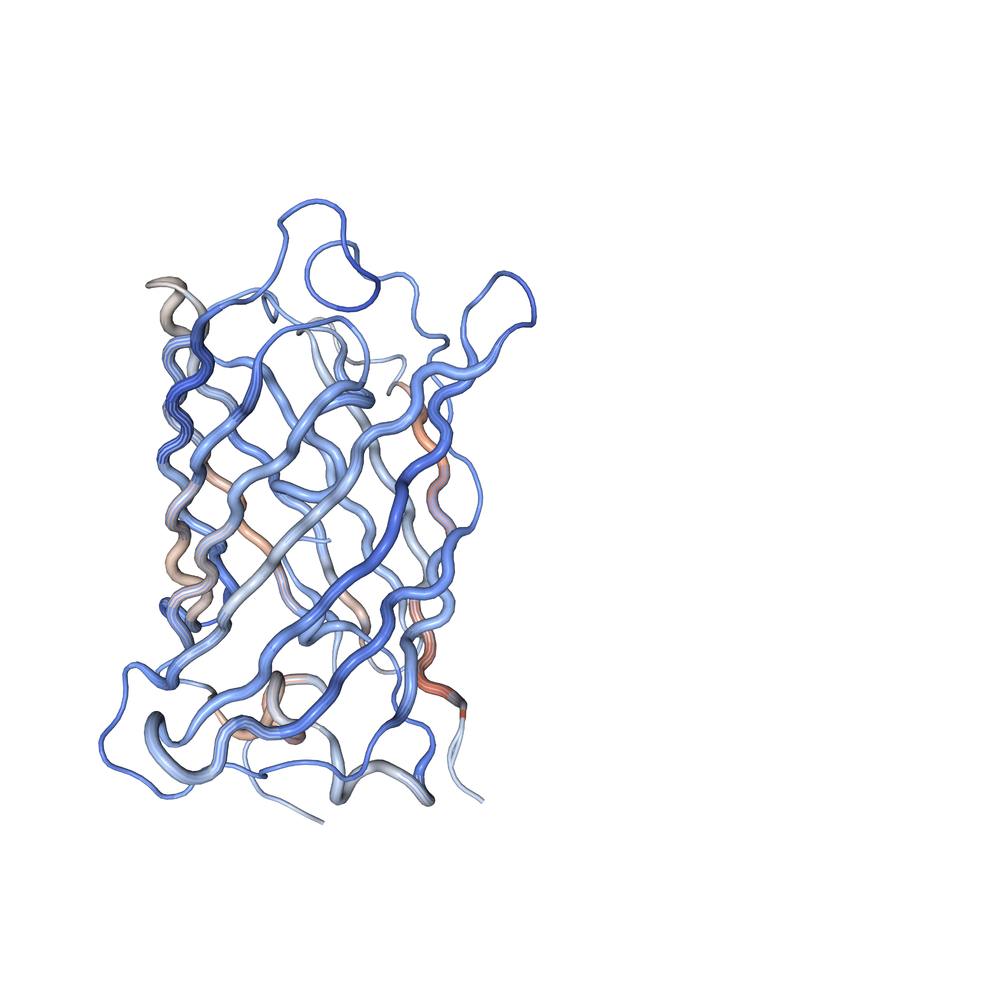

In [95]:
view._display_image()

## Supervised Sheet Model

In [96]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_sheet.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [97]:
view.render_image()

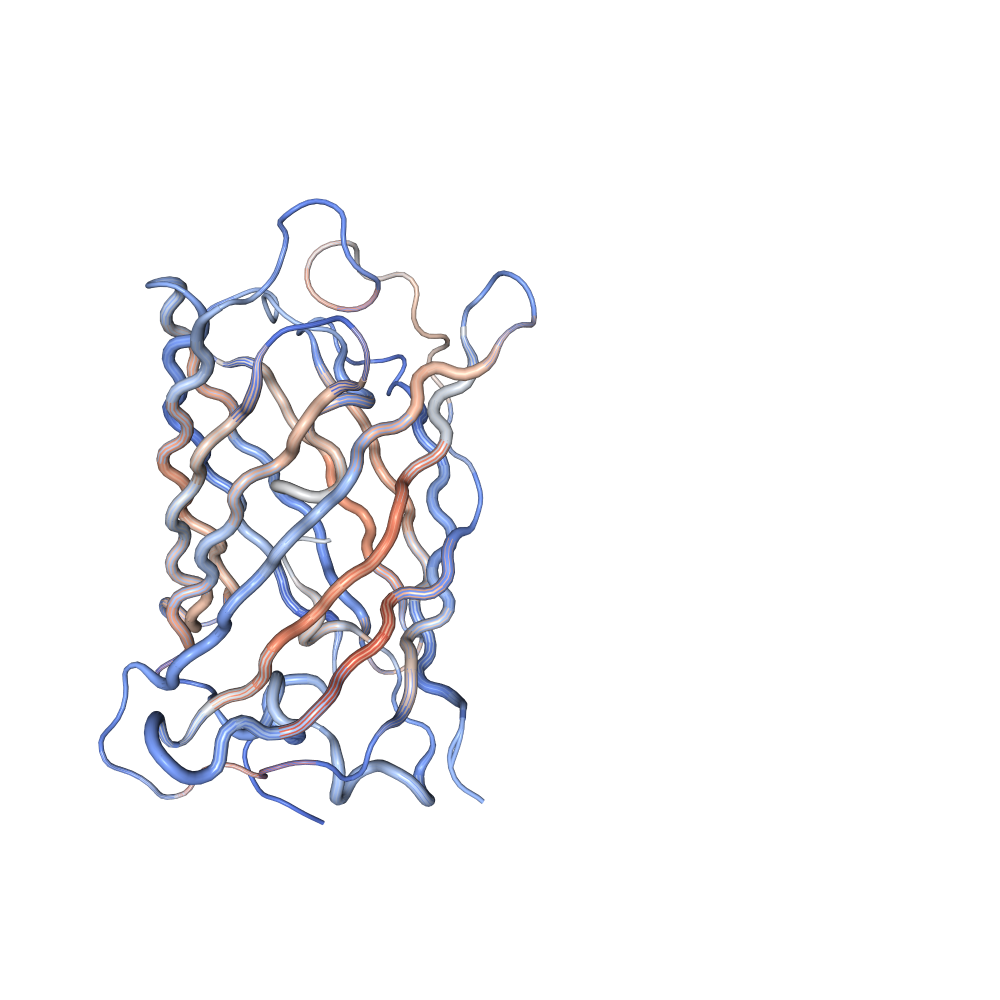

In [98]:
view._display_image()

## Solvent accessibility model

In [99]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, rep_model_asa.predict, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [100]:
view.render_image()

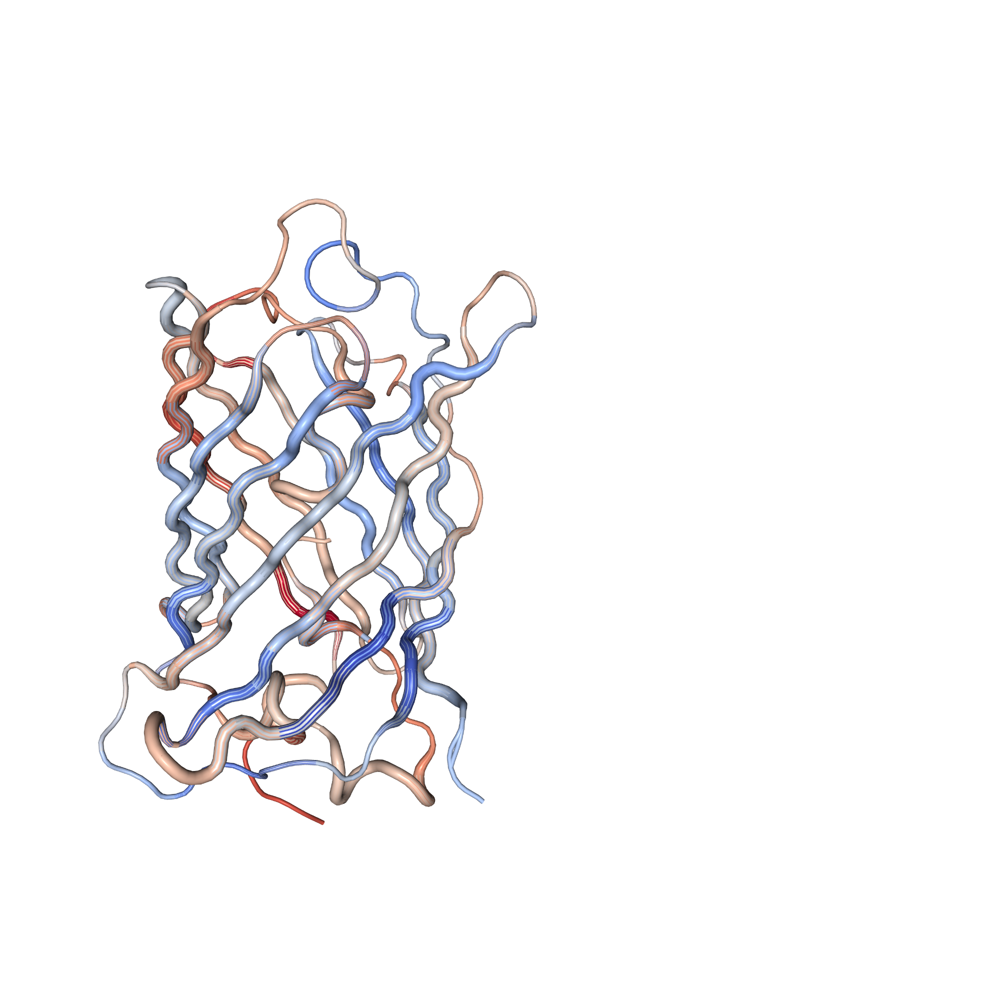

In [101]:
view._display_image()

## Top Helix Neuron

In [102]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_HELIX_NEURON].reshape(-1,1)*A008_common.TOP_HELIX_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)

view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [103]:
view.render_image()

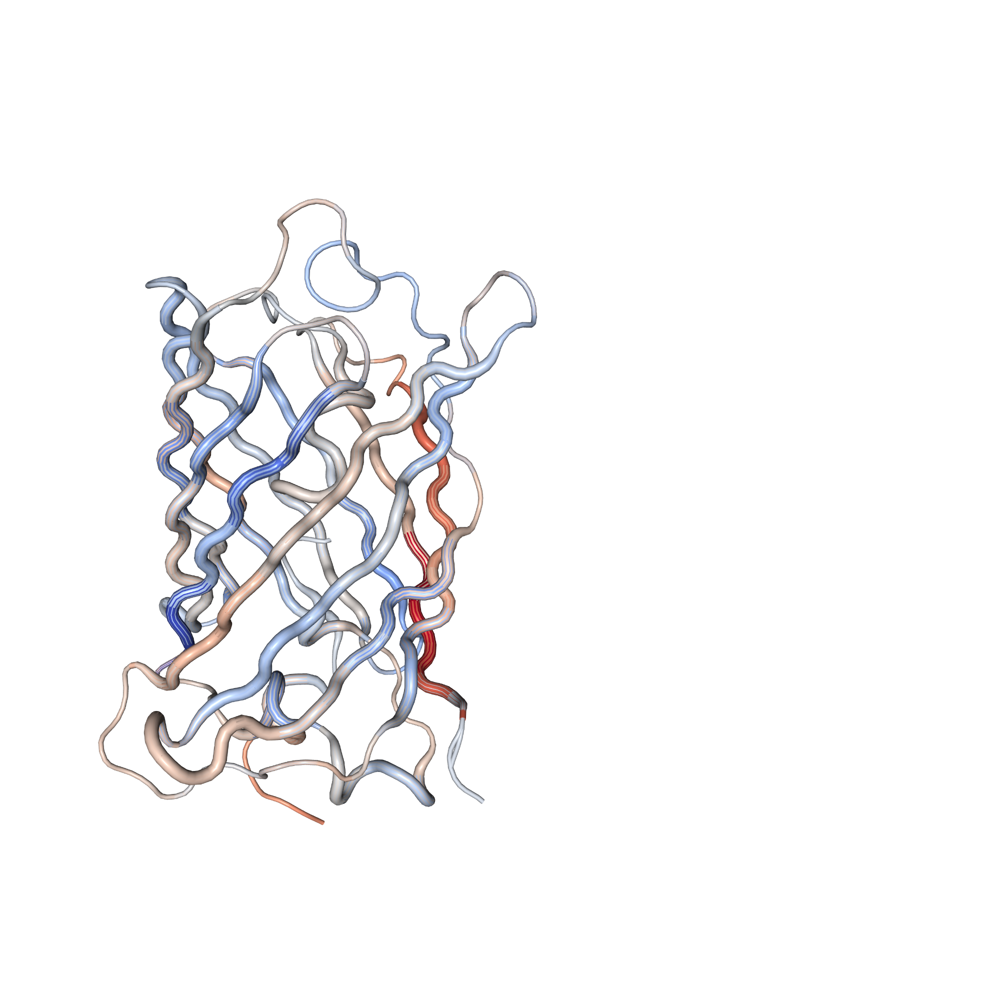

In [104]:
view._display_image()

## Top Sheet Neuron

In [105]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_SHEET_NEURON].reshape(-1,1)*A008_common.TOP_SHEET_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)

view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [106]:
view.render_image()

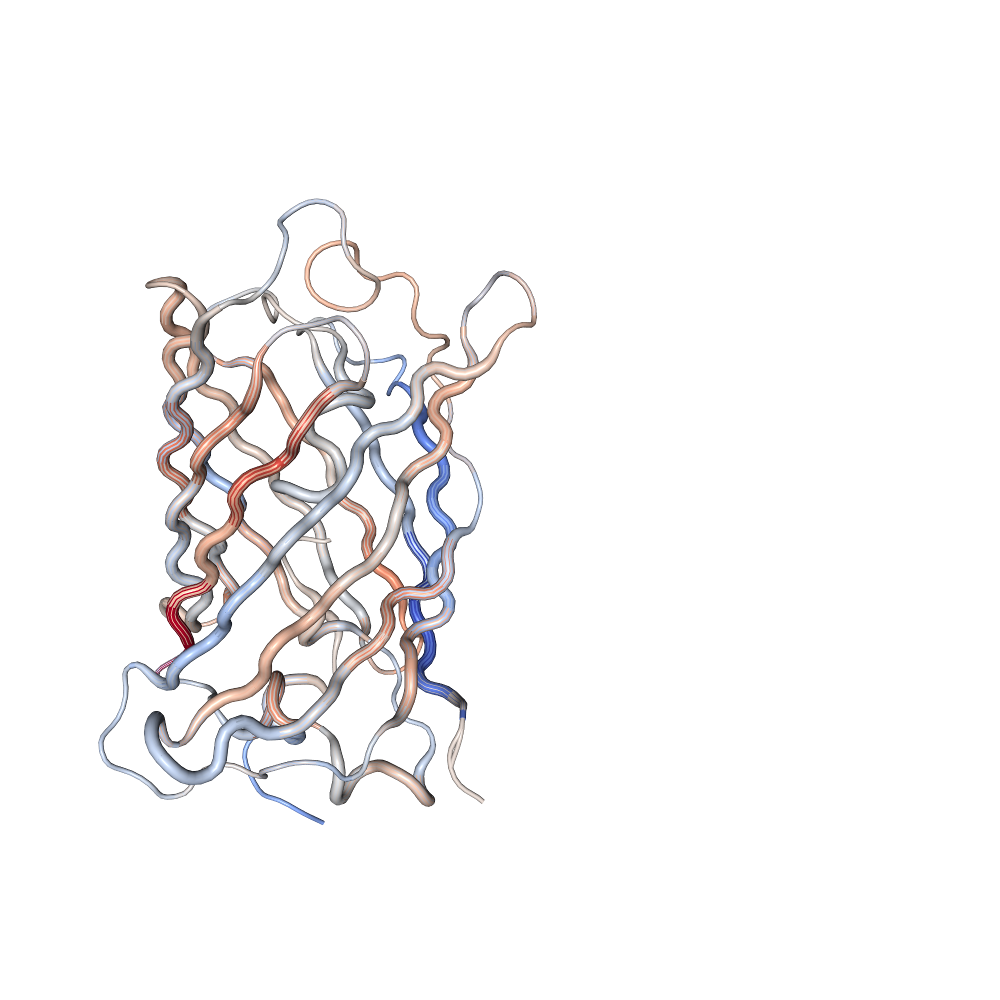

In [107]:
view._display_image()

## Stability Predictor (4 co-activated neurons found in Rocklin analysis)

In [108]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, A008_common.stability_predictor, 
        orientation_pickle=ORIENTATION_PICKLE)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [109]:
view.render_image()

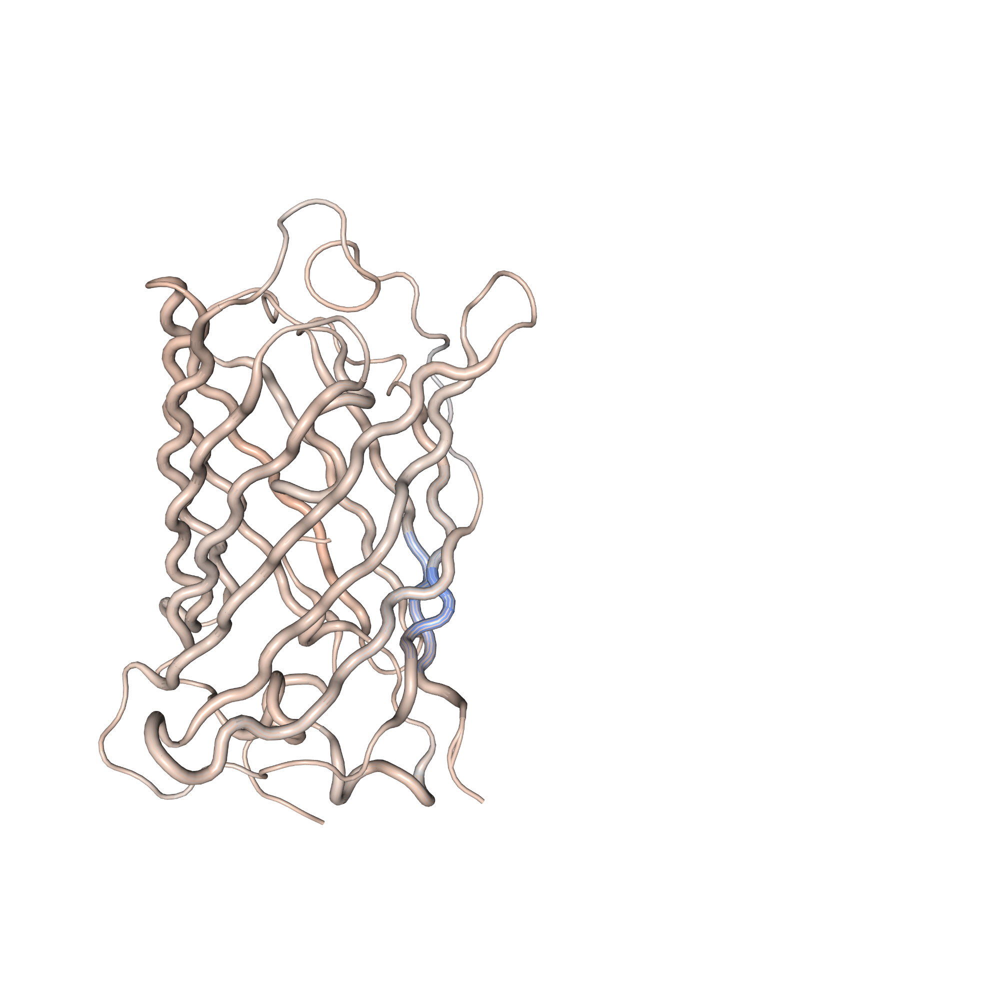

In [110]:
view._display_image()

# Rocklin designed protein

In [113]:
PDB_ID = '5UOI'
ORIENTATION_PICKLE = PDB_ID + '_orientation.p'
seq = 'RKWEEIAERLREEFNINPEEAREAVEKAGGNEEEARRIVKKRL'

hseq_file = os.path.join(settings.S3_DATA_ROOT, 'swiss_pca', 'just_wt_ssm2', 'hidden_sequences.npy')
data_io_utils.sync_s3_path_to_local(hseq_file, is_single_file=True)
hseq = np.load(hseq_file)[11][1:,:]

## Top helix neuron

In [114]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_HELIX_NEURON].reshape(-1,1)*A008_common.TOP_HELIX_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)


view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE, seq=seq, hseq=hseq)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

In [115]:
if False: 
    orientation = view._camera_orientation
    with open(ORIENTATION_PICKLE, 'wb') as f:
            pickle.dump(orientation, f)

In [116]:
view.render_image()

In [117]:
view.download_image(filename='rocklin_helix_neuron.png', trim=True, transparent=True)

## Top Sheet Neuron

In [19]:
def hseq2propval(hseq):
    x = hseq[:,A008_common.TOP_SHEET_NEURON].reshape(-1,1)*A008_common.TOP_SHEET_NEURON_SIGN
    return rep_model_helix_top_neuron.predict(x)


view = visualize_protein_given_hidden_seq_model(PDB_ID, hseq2propval, 
        orientation_pickle=ORIENTATION_PICKLE, seq=seq, hseq=hseq)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

## Stability Predictor (4 co-activated neurons found in Rocklin analysis)

In [116]:
view = visualize_protein_given_hidden_seq_model(PDB_ID, A008_common.stability_predictor, 
        orientation_pickle=ORIENTATION_PICKLE, seq=seq, hseq=hseq)

# Center and zoom molecule
view.center()
view.display()

NGLWidget()

/home/ubuntu/GitHub/protein-representation-learning-analysis/venv/lib/python3.5/site-packages/matplotlib/font_manager.py:1328: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


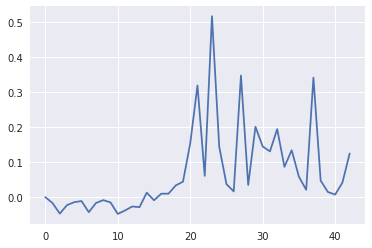

In [120]:
plt.plot(A008_common.stability_predictor(hseq).reshape(-1))
plt.show()